In [1]:
# MODEL 3. MIN MAX
from sklearn.metrics import classification_report
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score, ConfusionMatrixDisplay, RocCurveDisplay
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category = DeprecationWarning)
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

from sklearn.preprocessing import MinMaxScaler
file_path = r'./Loan_default.csv'
loan_df = pd.read_csv(file_path)
loan_df.head(3)

,LoanID,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,Education,EmploymentType,MaritalStatus,HasMortgage,HasDependents,LoanPurpose,HasCoSigner,Default
0,I38PQUQS96,56,85994,50587,520,80,4,15.23,36,0.44,Bachelor's,Full-time,Divorced,Yes,Yes,Other,Yes,0
1,HPSK72WA7R,69,50432,124440,458,15,1,4.81,60,0.68,Master's,Full-time,Married,No,No,Other,Yes,0
2,C1OZ6DPJ8Y,46,84208,129188,451,26,3,21.17,24,0.31,Master's,Unemployed,Divorced,Yes,Yes,Auto,No,1


In [2]:
loan_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 255347 entries, 0 to 255346
Data columns (total 18 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   LoanID          255347 non-null  object 
 1   Age             255347 non-null  int64  
 2   Income          255347 non-null  int64  
 3   LoanAmount      255347 non-null  int64  
 4   CreditScore     255347 non-null  int64  
 5   MonthsEmployed  255347 non-null  int64  
 6   NumCreditLines  255347 non-null  int64  
 7   InterestRate    255347 non-null  float64
 8   LoanTerm        255347 non-null  int64  
 9   DTIRatio        255347 non-null  float64
 10  Education       255347 non-null  object 
 11  EmploymentType  255347 non-null  object 
 12  MaritalStatus   255347 non-null  object 
 13  HasMortgage     255347 non-null  object 
 14  HasDependents   255347 non-null  object 
 15  LoanPurpose     255347 non-null  object 
 16  HasCoSigner     255347 non-null  object 
 17  Default   

In [3]:
loan_df.drop_duplicates()

,LoanID,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,Education,EmploymentType,MaritalStatus,HasMortgage,HasDependents,LoanPurpose,HasCoSigner,Default
0,I38PQUQS96,56,85994,50587,520,80,4,15.23,36,0.44,Bachelor's,Full-time,Divorced,Yes,Yes,Other,Yes,0
1,HPSK72WA7R,69,50432,124440,458,15,1,4.81,60,0.68,Master's,Full-time,Married,No,No,Other,Yes,0
2,C1OZ6DPJ8Y,46,84208,129188,451,26,3,21.17,24,0.31,Master's,Unemployed,Divorced,Yes,Yes,Auto,No,1
3,V2KKSFM3UN,32,31713,44799,743,0,3,7.07,24,0.23,High School,Full-time,Married,No,No,Business,No,0
4,EY08JDHTZP,60,20437,9139,633,8,4,6.51,48,0.73,Bachelor's,Unemployed,Divorced,No,Yes,Auto,No,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
255342,8C6S86ESGC,19,37979,210682,541,109,4,14.11,12,0.85,Bachelor's,Full-time,Married,No,No,Other,No,0
255343,98R4KDHNND,32,51953,189899,511,14,2,11.55,24,0.21,High School,Part-time,Divorced,No,No,Home,No,1
255344,XQK1UUUNGP,56,84820,208294,597,70,3,5.29,60,0.50,High School,Self-employed,Married,Yes,Yes,Auto,Yes,0
255345,JAO28CPL4H,42,85109,60575,809,40,1,20.90,48,0.44,High School,Part-time,Single,Yes,Yes,Other,No,0


In [4]:
loan_df.columns

Index(['LoanID', 'Age', 'Income', 'LoanAmount', 'CreditScore',
       'MonthsEmployed', 'NumCreditLines', 'InterestRate', 'LoanTerm',
       'DTIRatio', 'Education', 'EmploymentType', 'MaritalStatus',
       'HasMortgage', 'HasDependents', 'LoanPurpose', 'HasCoSigner',
       'Default'],
      dtype='object')

In [5]:
loan_df = loan_df.rename(columns= {'Default':'LoanApproved'})

In [7]:
numerical_var= ['Age', 'Income', 'LoanAmount', 'CreditScore','MonthsEmployed', 'NumCreditLines', 'InterestRate', 'LoanTerm','DTIRatio']
categorical_var = ['Education', 'EmploymentType', 'MaritalStatus', 'HasMortgage', 'HasDependents', 'LoanPurpose', 'HasCoSigner']

In [8]:
loan_df.describe()

,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,LoanApproved
count,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000
mean,43.498306,82499.304597,127578.865512,574.264346,59.541976,2.501036,13.492773,36.025894,0.500212,0.116128
std,14.990258,38963.013729,70840.706142,158.903867,34.643376,1.117018,6.636443,16.969330,0.230917,0.320379
min,18.000000,15000.000000,5000.000000,300.000000,0.000000,1.000000,2.000000,12.000000,0.100000,0.000000
25%,31.000000,48825.500000,66156.000000,437.000000,30.000000,2.000000,7.770000,24.000000,0.300000,0.000000
50%,43.000000,82466.000000,127556.000000,574.000000,60.000000,2.000000,13.460000,36.000000,0.500000,0.000000
75%,56.000000,116219.000000,188985.000000,712.000000,90.000000,3.000000,19.250000,48.000000,0.700000,0.000000
max,69.000000,149999.000000,249999.000000,849.000000,119.000000,4.000000,25.000000,60.000000,0.900000,1.000000


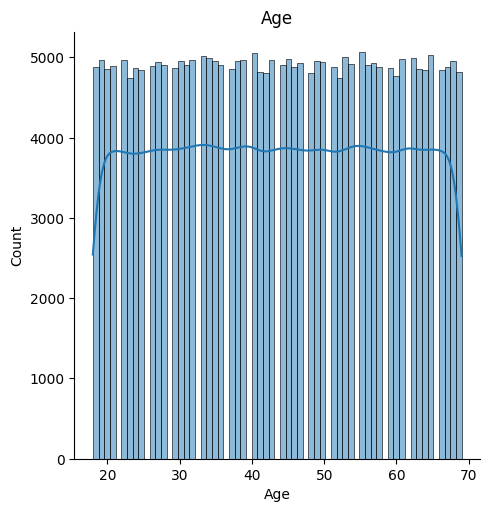

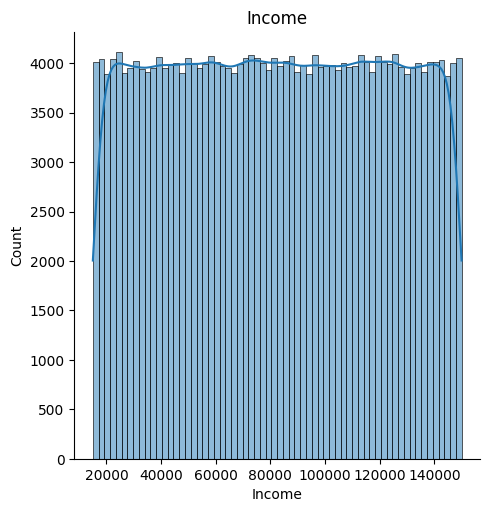

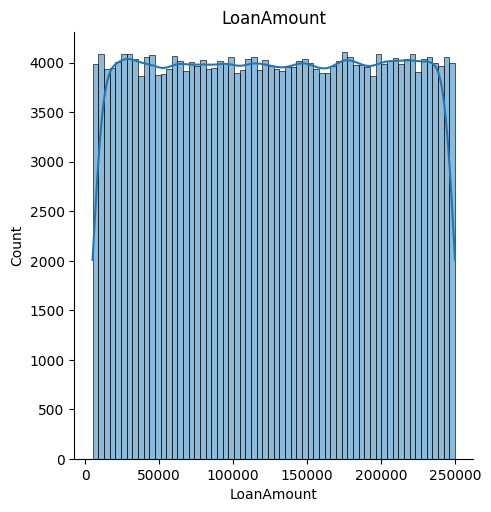

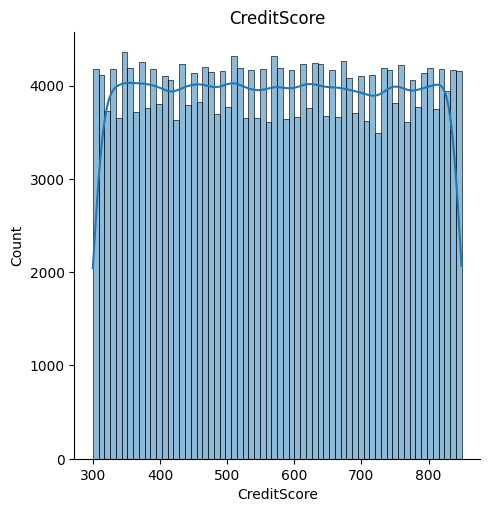

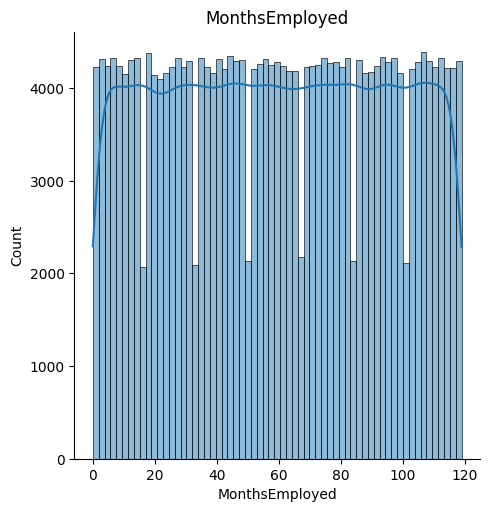

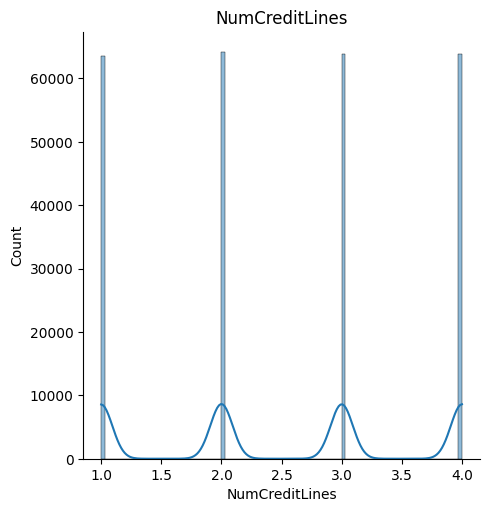

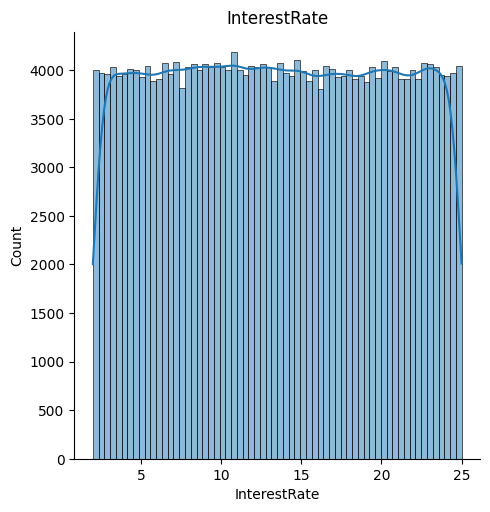

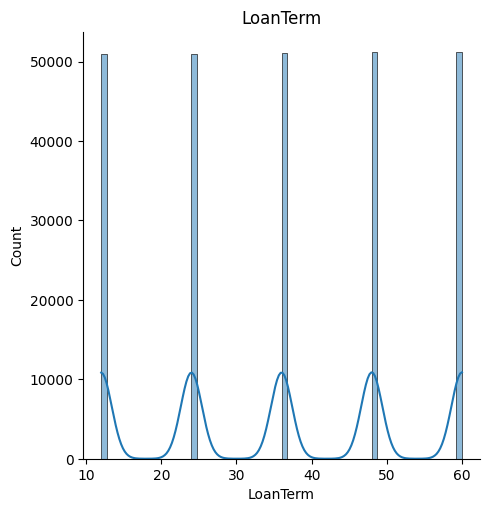

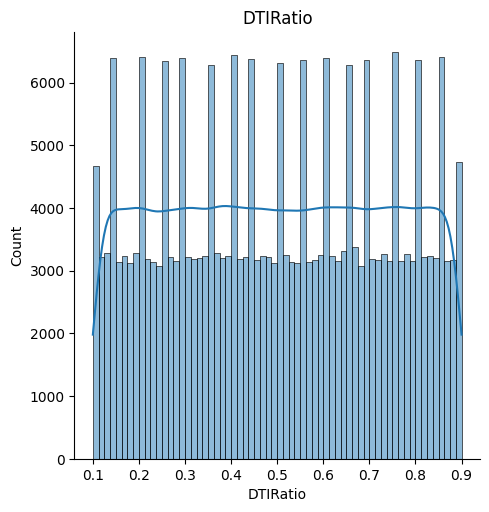

In [10]:
for col in numerical_var:
    sns.displot(loan_df[col], kde= True)
    plt.title(col)
    plt.show()

In [11]:
for numfeat in numerical_var:
    fig = px.histogram(loan_df, numfeat, histnorm="probability")
    fig.show()

In [9]:
loan_df.corr(numeric_only=True)

,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,LoanApproved
Age,1.000000,-0.001244,-0.002213,-0.000548,-0.000341,-0.000890,-0.001127,0.000263,-0.004689,-0.167783
Income,-0.001244,1.000000,-0.000865,-0.001430,0.002675,-0.002016,-0.002303,-0.000998,0.000205,-0.099119
LoanAmount,-0.002213,-0.000865,1.000000,0.001261,0.002817,0.000794,-0.002291,0.002538,0.001122,0.086659
CreditScore,-0.000548,-0.001430,0.001261,1.000000,0.000613,0.000016,0.000436,0.001130,-0.001039,-0.034166
MonthsEmployed,-0.000341,0.002675,0.002817,0.000613,1.000000,0.001267,0.000096,-0.001166,0.001765,-0.097374
NumCreditLines,-0.000890,-0.002016,0.000794,0.000016,0.001267,1.000000,-0.000297,-0.000226,-0.000586,0.028330
InterestRate,-0.001127,-0.002303,-0.002291,0.000436,0.000096,-0.000297,1.000000,0.000892,0.000575,0.131273
LoanTerm,0.000263,-0.000998,0.002538,0.001130,-0.001166,-0.000226,0.000892,1.000000,0.002273,0.000545
DTIRatio,-0.004689,0.000205,0.001122,-0.001039,0.001765,-0.000586,0.000575,0.002273,1.000000,0.019236
LoanApproved,-0.167783,-0.099119,0.086659,-0.034166,-0.097374,0.028330,0.131273,0.000545,0.019236,1.000000


<Axes: >

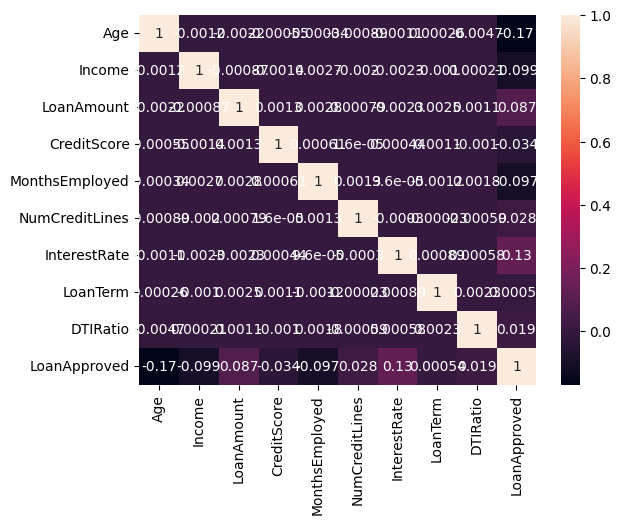

In [33]:
sns.heatmap(df_corr, annot=True)

In [ ]:
categorical_var

['Education',
 'EmploymentType',
 'MaritalStatus',
 'HasMortgage',
 'HasDependents',
 'LoanPurpose',
 'HasCoSigner']

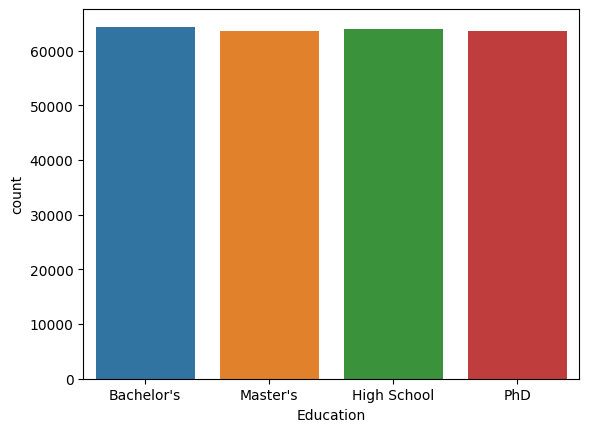

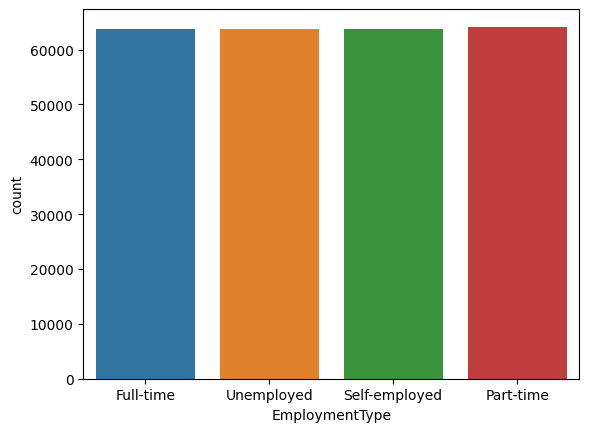

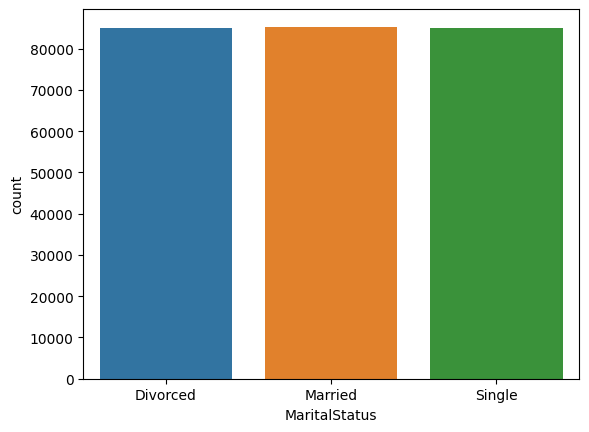

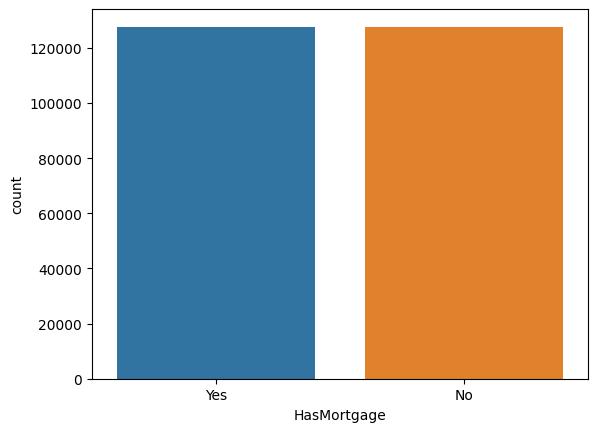

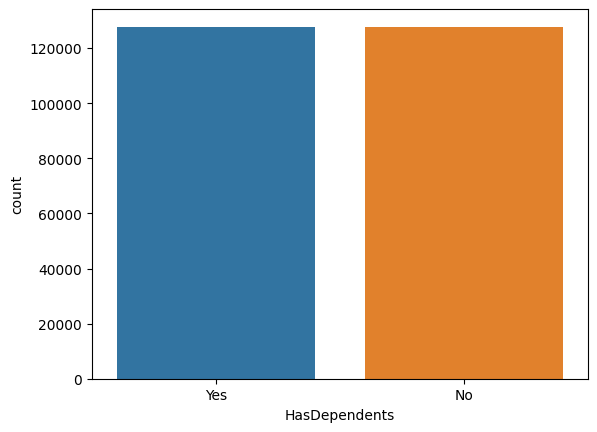

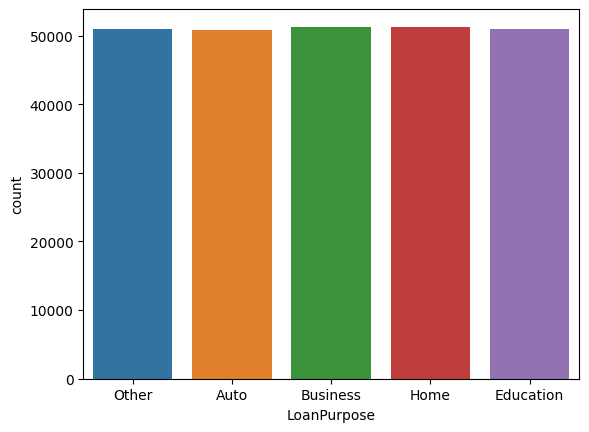

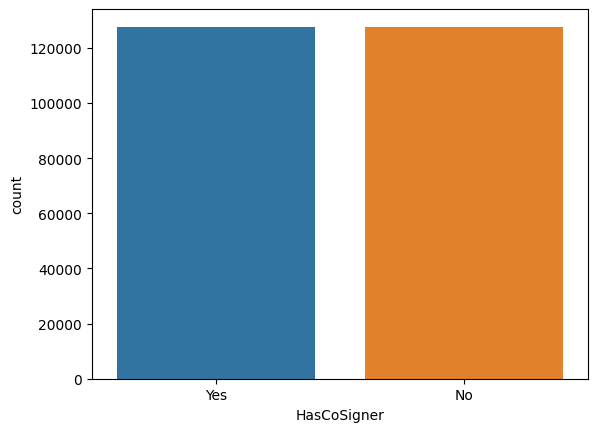

In [10]:
loan_df_categorical = loan_df[categorical_var]
for col in categorical_var:
    sns.countplot(x = col, data = loan_df_categorical, hue =col)
    plt.show()

In [12]:
X = loan_df.drop(['LoanID', 'LoanTerm', 'LoanApproved'], axis = 1)

y = loan_df['LoanApproved']


In [13]:
X.columns

Index(['Age', 'Income', 'LoanAmount', 'CreditScore', 'MonthsEmployed',
       'NumCreditLines', 'InterestRate', 'DTIRatio', 'Education',
       'EmploymentType', 'MaritalStatus', 'HasMortgage', 'HasDependents',
       'LoanPurpose', 'HasCoSigner'],
      dtype='object')

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.20, random_state =0)

In [15]:
numeric_transformer = Pipeline(steps = [("imputer", SimpleImputer(strategy="mean")),
                                       ("scaler", MinMaxScaler())
                                       ])
categorical_transformer = OneHotEncoder(drop = "first")

In [17]:

numeric_features = ['Age', 'Income', 'LoanAmount', 'CreditScore','MonthsEmployed', 'NumCreditLines', 'InterestRate', 'DTIRatio']

categorical_features = ['Education', 'EmploymentType', 'MaritalStatus','HasMortgage', 'HasDependents', 'LoanPurpose', 'HasCoSigner']

In [18]:
preprocessor = ColumnTransformer(
            transformers = [("numerical", numeric_transformer, numeric_features), 
                            ("categorical", categorical_transformer, categorical_features)]
)

In [19]:
X_train = preprocessor.fit_transform(X_train)
X_test = preprocessor.transform(X_test)

In [20]:

encoder = LabelEncoder()

y_train = encoder.fit_transform(y_train)
y_test = encoder.transform(y_test)


In [21]:

classifier = LogisticRegression()
classifier.fit(X_train, y_train)

LogisticRegression()

In [22]:
pred_train = classifier.predict(X_train)
pred_test = classifier.predict(X_test)


array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [23]:
prob_train = classifier.predict_proba(X_train)
prob_test = classifier.predict_proba(X_test)


In [24]:
print("accuracy on train set:", accuracy_score(y_train, pred_train))
print("accuracy on test set:", accuracy_score(y_test, pred_test))
print("f1 score on train set:", f1_score(y_train, pred_train))
print("f1 score on test set:", f1_score(y_test, pred_test))

accuracy on train set: 0.8854153918453864
accuracy on test set: 0.8840023497160759
f1 score on train set: 0.06405693950177936
f1 score on test set: 0.06679269061121614


In [25]:
from sklearn.metrics import classification_report
print(classification_report(y_train, pred_train))
print(classification_report(y_test, pred_test))

              precision    recall  f1-score   support

           0       0.89      1.00      0.94    180632
           1       0.59      0.03      0.06     23645

    accuracy                           0.89    204277
   macro avg       0.74      0.52      0.50    204277
weighted avg       0.85      0.89      0.84    204277

              precision    recall  f1-score   support

           0       0.89      1.00      0.94     45062
           1       0.62      0.04      0.07      6008

    accuracy                           0.88     51070
   macro avg       0.75      0.52      0.50     51070
weighted avg       0.85      0.88      0.84     51070



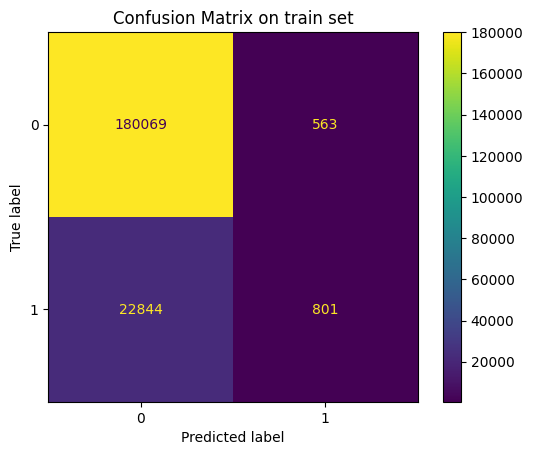

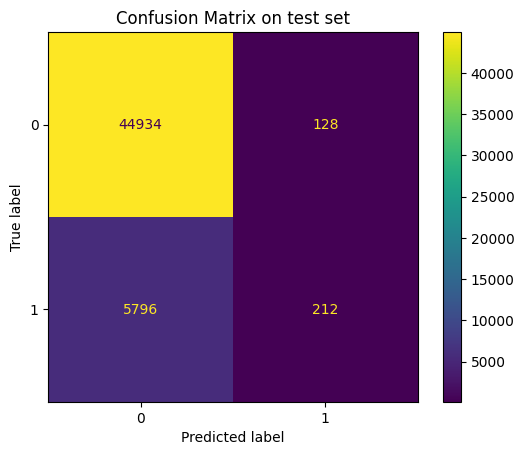

In [26]:
_, ax= plt.subplots()
ax.set(title = "Confusion Matrix on train set")
ConfusionMatrixDisplay.from_estimator(classifier, X_train, y_train, ax=ax)
plt.show()


_, ax= plt.subplots()
ax.set(title = "Confusion Matrix on test set")
ConfusionMatrixDisplay.from_estimator(classifier, X_test, y_test, ax=ax)
plt.show()

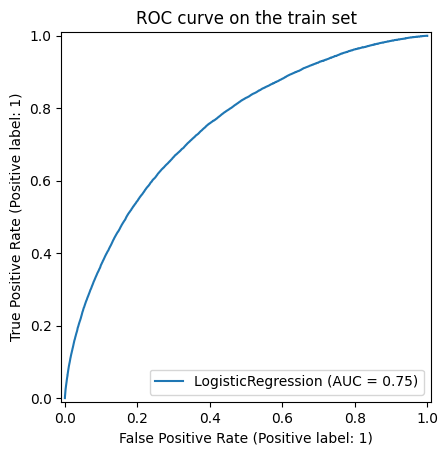

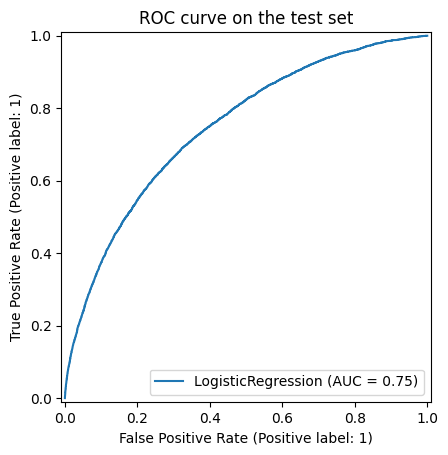

In [27]:
_, ax = plt.subplots()
ax.set(title = "ROC curve on the train set")
RocCurveDisplay.from_estimator(classifier, X_train, y_train, ax=ax)
plt.show()

_, ax = plt.subplots()
ax.set(title = "ROC curve on the test set")
RocCurveDisplay.from_estimator(classifier, X_test, y_test, ax=ax)
plt.show()